In [1]:
from mydataset.e3sm_seq_overlap import Climate240
from models.CDC import keyframe_compressor as compress_modules
import torch
import torch.nn as nn
import importlib
import models
importlib.reload(compress_modules)
from models.CDC import keyframe_compressor as compress_modules


pretrain = "/blue/ranka/shared-liangji/finetuning result/model_bs32_ep100k.pt"
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

keyframe_model = compress_modules.ResnetCompressor()
keyframe_model.load_pretrain(pretrain)
keyframe_model = keyframe_model.to(device).eval()

/apps/pytorch/2.2.0/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loaded pretrained weights from /blue/ranka/shared-liangji/finetuning result/model_bs32_ep100k.pt


In [3]:
from models.video_diffusion_interpo import Unet3D, GaussianDiffusion

importlib.reload(models.video_diffusion_interpo)
from models.video_diffusion_interpo import Unet3D, GaussianDiffusion

import torch

time_steps = 1000

model = Unet3D(
    dim = 64,
    out_dim = 64,
    channels = 64,
    dim_mults = (1, 2, 4, 8),
    use_bert_text_cond = False
)

diffusion = GaussianDiffusion(
    model,
    image_size = 16,
    num_frames = 10,
    channels = 64,
    timesteps = time_steps,   # number of steps
    loss_type = 'l2'    # L1 or L2
).cuda()

interpo_rate = 3

diffusion_path = "/blue/ranka/shared-liangji/finetuning result/model-12.pt"
data = torch.load(diffusion_path)
diffusion.load_state_dict(data['ema'])

diffusion.zero_noise = False

In [4]:
base_frame = 720

cond_idx = torch.arange(0,16,interpo_rate)
max_index = cond_idx[-1].item()

valid_mask = ~torch.isin(torch.arange(16), cond_idx)
valid_mask[max_index:] = False
    
overlap = 16 - max_index
extra_frame = (((base_frame - 16)//(16- overlap)+1) * (16- overlap) + 16 - base_frame)%15


diffusion.num_frames = 16- len(cond_idx)

total_frame = base_frame + extra_frame

interpo_rate, overlap, extra_frame, cond_idx


(3, 1, 1, tensor([ 0,  3,  6,  9, 12, 15]))

In [23]:
n_frame = 16
frame_range = [0,721]

from mydataset.dataset import ScientificDataset
data_arg = {"data_path":"/blue/ranka/shared-xiaoli/ScientificDataset/E3SM/e3sm_1.npz",
            "variable_idx": [0],
            "section_range": [0,6],
            "frame_range": frame_range,
            "n_frame":n_frame,
            "n_overlap":1,
            "train": False,
            "train_size":256,
            "test_size":(256,256),
            "inst_norm": True, "norm_type":'mean_range_hw'}

dataset_org = ScientificDataset(data_arg)

total_frames = frame_range[1] - frame_range[0]

*************** Loading E3SM ***************
Original Data Shape (1, 6, 721, 240, 240)
Testing Data Shape torch.Size([1, 6, 721, 256, 256])


In [24]:
# [dataset_org[0][key].shape for key in dataset_org[0].keys()]

In [36]:
original_data= dataset_org.deblocking_hw(dataset_org.data_input)

In [37]:
original_data.shape

torch.Size([1, 6, 721, 240, 240])

In [27]:
def normalize_latent(x):
    B = x.shape[0]
    x_min = x.view(B, -1).min(dim=1, keepdim=True)[0].view(B, 1, 1, 1, 1)
    x_max = x.view(B, -1).max(dim=1, keepdim=True)[0].view(B, 1, 1, 1, 1)

    scale = (x_max - x_min + 1e-8) / 2
    offset = x_min + scale

    x_norm = (x - offset) / scale  # result in [-1, 1]

    return x_norm,  offset,scale

In [28]:
from torch.utils.data import DataLoader
from time import time
import numpy as np
from tools_online.io.json_io import save_json

dataloader =  DataLoader(dataset_org, batch_size=64, shuffle=False, num_workers=2)
pred_idx = ~torch.isin(torch.arange(n_frame), cond_idx)

start = time()

recons_data = torch.zeros_like(dataset_org.data_input)

diffusion.num_timesteps = 1000
total_bits = 0
frame_count = 0
with torch.no_grad():
    for data in dataloader:
        input_data = data["input"]
        pixel_shape = input_data.shape
        batch_size =pixel_shape[0]
        
        
        keyframe = input_data[:,:,cond_idx].cuda()
        compressed_data, nbits_each_frame = keyframe_model.compress(keyframe)

        total_bits += np.sum(nbits_each_frame.reshape([batch_size, -1])[:,:-1])
        
        latent_data = keyframe_model.decompress(*compressed_data, device = device)
        B,C,KT,H,W = latent_data.shape

        input_latent = torch.zeros([B,C,n_frame,H,W], device = device)
        input_latent[:,:,cond_idx] = latent_data

        # result = F.interpolate(input_data[:,:,cond_idx], scale_factor=(interpo_rate, 1, 1), mode='trilinear', align_corners=False)
        # result = result[:,:,:16][:,:,pred_idx]
        start = time()
        input_latent,offset_latent, scale_latent = normalize_latent(input_latent)
        result = diffusion.sample(input_latent, interpo_rate, batch_size=input_latent.shape[0])
        input_latent[:,:,pred_idx] = result
        input_latent = input_latent*scale_latent + offset_latent
        
        input_latent = input_latent[:,:,:].permute(0,2,1,3,4).reshape(-1,64,16,16) #remove overlap

        rct_data = keyframe_model.decode(input_latent).detach().reshape(pixel_shape)*data["scale"].cuda() + data["offset"].cuda()
        rct_data = rct_data.cpu()
        
        for i in range(batch_size):
            idx0, idx1, start_t, end_t = data["index"]
            recons_data[idx0[i], idx1[i], start_t[i]:end_t[i]] = rct_data[i]
            


sampling loop time step: 100%|██████████| 1000/1000 [01:05<00:00, 15.19it/s]


In [41]:
original_data2 = original_data*data["scale"][0].squeeze() + data["offset"][0].squeeze()

In [29]:
recons_data2 = dataset_org.deblocking_hw(recons_data)

In [43]:
recons_data2.shape , original_data.shape

(torch.Size([1, 6, 721, 240, 240]), torch.Size([1, 6, 721, 240, 240]))

In [45]:
torch.sqrt(torch.mean((recons_data2 - original_data2)**2, axis = (0,1,2,3,4)))/(torch.max(original_data2) - torch.min(original_data2))

tensor(0.0015)

In [46]:
y = recons_data2.numpy()[:,:,:720].reshape([-1, 30,8, 30,8]).transpose(0,1,3,2,4).reshape([-1, 64])
x = original_data2.numpy()[:,:,:720].reshape([-1, 30,8, 30,8]).transpose(0,1,3,2,4).reshape([-1, 64])

In [47]:
x.shape, y.shape

((3888000, 64), (3888000, 64))

In [48]:
np.prod(recons_data2.shape)*32/total_bits

300.972208298255

In [49]:
np.savez("../LatentDiffusion/data/E3SM/Liangji_finetuning_noinstnorm_mean_range.npz", original_data = x, recons_data = y, latent_bit = total_bits)

In [38]:
latent_data.shape

torch.Size([32, 64, 6, 16, 16])

In [39]:
240*240*32/nbits_each_frame.reshape([batch_size, -1])

array([[53.48189415, 52.74725275, 53.18559557, 52.41128298, 51.47453083,
        52.45901639],
       [52.45901639, 52.45901639, 52.55474453, 52.65082267, 52.6989936 ,
        53.48189415],
       [53.48189415, 53.0875576 , 52.03252033, 52.31607629, 53.13653137,
        53.2839963 ],
       [53.2839963 , 53.13653137, 54.44234405, 54.49385052, 52.79560037,
        51.9386835 ],
       [51.9386835 , 51.47453083, 51.84518452, 50.79365079, 50.65963061,
        50.17421603],
       [50.17421603, 51.2455516 , 51.01860053, 50.88339223, 51.01860053,
        51.15452931],
       [51.15452931, 51.06382979, 51.52057245, 50.97345133, 52.03252033,
        53.18559557],
       [53.18559557, 53.38276182, 53.48189415, 54.75285171, 54.49385052,
        54.13533835],
       [54.13533835, 54.85714286, 55.06692161, 55.17241379, 54.03377111,
        53.73134328],
       [53.73134328, 53.73134328, 53.63128492, 53.2839963 , 52.55474453,
        52.079566  ],
       [52.079566  , 51.52057245, 51.47453083, 51.

In [41]:
220/1.13

194.69026548672568

In [40]:
32/keyframe_model(keyframe)['bpp']*3/1.13

OutOfMemoryError: CUDA out of memory. Tried to allocate 768.00 MiB. GPU 0 has a total capacity of 79.14 GiB of which 38.75 MiB is free. Including non-PyTorch memory, this process has 79.09 GiB memory in use. Of the allocated memory 78.15 GiB is allocated by PyTorch, and 453.51 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [ ]:
keyframe.shape

In [ ]:
original_data.shape

In [ ]:
np.prod(original_data.shape)/bit_count *32

In [ ]:
bit_count

In [ ]:
32/(nbits/np.prod(keyframe.shape))*3

In [ ]:
data['scale'].shape

In [36]:
32/(nbits/np.prod(keyframe.shape))


np.savez("./test.npz", original_data = original_data, recons_data =recons_data )

In [31]:
np.prod(original_data.shape)*32/bit_count

175.9090070291399

In [33]:
original_data.shape

(6, 720, 256, 256)

In [33]:
256-240

16

In [36]:
depad = 8
recons_data2  = recons_data[...,depad:-depad,depad:-depad].reshape([-1, 30, 8, 30, 8]).transpose([0,1,3,2,4]).reshape([-1, 64]).astype(np.float32)
original_data2  = original_data[...,depad:-depad,depad:-depad].reshape([-1, 30, 8, 30, 8]).transpose([0,1,3,2,4]).reshape([-1, 64]).astype(np.float32)
original_data2.dtype, recons_data2.shape, original_data2.shape

save_data = True

if save_data:
    np.savez("../LatentDiffusion/data/FMCLD/firstNoInstNorm.npz", 
             original_data = original_data2,  recons_data = recons_data2, latent_bit = int(bit_count), 
             path = pretrain,
             path_diffusion = diffusion_path)

In [37]:
original_data2.shape

(3888000, 64)

In [21]:
torch.cat(recons_data, dim=0).shape,torch.cat(original_data, dim=0).shape

(torch.Size([288, 1, 15, 256, 256]), torch.Size([288, 1, 16, 256, 256]))

In [15]:
720/

48.0

In [9]:
data['scale'].view([-1])

tensor([4203.7734, 4096.1797, 4015.1094,  ..., 5508.9297, 5505.2656,
        5489.0312])

In [ ]:
32/0.4514, 32/0.50

In [ ]:
keyframe.numel(), keyframe.shape

In [ ]:
64*6*256*256

In [ ]:
len(compressed_data[0][2]), len(compressed_data[1][2])

In [ ]:
cr = 64/torch.mean(all_bbp)*interpo_rate

total_bits = (all_bbp*256*256).sum().item()/total_frame*base_frame

cr2 = recons_data.nbytes * 8/(total_bits)

cr, cr2

In [ ]:
def relative_rmse_error_ornl(x, y):
    """Compute the relative RMSE between two arrays."""
    try:
        assert x.shape == y.shape
    except:
        print("x.shape != y.shape", x.shape, y.shape)
        
    mse = np.mean((x - y)**2)
    maxv = np.max(x)
    minv = np.min(x)
    return np.sqrt(mse) / (maxv - minv)



In [24]:
original_data.shape

(6, 720, 256, 256)

In [26]:
import numpy as np

x = original_data
y = recons_data
error = np.sqrt(np.mean((x - y)**2, axis = (0,1,2,3)))/(x.max()-x.min())
nrmse = np.sqrt(np.mean((x - y)**2))/(x.max()-x.min())
nrmse, error

(0.0022087854, 0.0022087854)

In [32]:
240/8

30.0

(dtype('float64'), (204800, 64), (204800, 64))

In [19]:
recons_data.dtype

dtype('float64')

In [21]:
# import numpy as np
# original_data = np.load("./data/interpo16_result.npz")["original_data"]
# recons_data = np.load("./data/interpo16_result.npz")["recons_data"]
# error = np.sqrt(np.mean((original_data - recons_data)**2))/(original_data.max()-original_data.min())

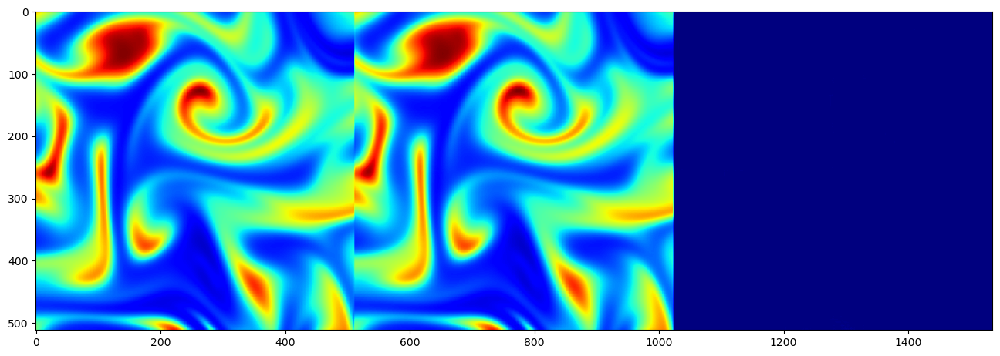

In [18]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import imageio
import numpy as np
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(16,10))
residual = np.abs(original_data - recons_data[:50])
video = np.concatenate([original_data, recons_data[:50], residual], axis = -1)
video = video[:]
# video = recons_data[:,0]

im = ax.imshow(video[0], cmap="jet")

def update(frame):
    im.set_array(video[frame])
    return [im]

ani = animation.FuncAnimation(fig, update, frames=len(video), interval=1)

# Save as a GIF
ani.save("animation.gif", writer=animation.PillowWriter(fps=5))

# Display in Jupyter Notebook
HTML(ani.to_jshtml())

In [119]:
from mydataset.e3sm_seq import Climate240

# results_folder = "./results/VD2_InstRange2Norm_4_16_E3SM64_OriginalDomain"

data_arg = {"data_path":"/blue/ranka/xiao.li/dataset/climate_dataset/dataset_numpy",
                        "var": [0,1,2,3,4],
                        "seq": [8],
                        "n_frame":16,
                        "downsampling":1,
                        "input_size":256,"inst_norm": False, "norm_type":'range'}

# dataset_arg = {"data_path":"./data", "n_frame":16, "inst_norm": True, "norm_type":'range2'}

dataset_org = Climate240(data_arg)

*************** Loading E3SM ***************
*************** Loading /blue/ranka/xiao.li/dataset/climate_dataset/dataset_numpy/08.npz ***************
Original Data Shape: (5, 6, 720, 240, 240)
self.data_input: (5, 6, 720, 240, 240)


In [120]:
from models.CDC import compress_modules_2d as compress_modules
import torch
import torch.nn as nn

pretrain = "./snapshots/MaskedAE/NoMask/model_bs16_ep500k.pt"
# args.pretrain = "./snapshots/MaskedAE/test/model_bs16_ep500k_final.pt"
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# main(args)

modelAE = compress_modules.ResnetCompressor(  dim= 16,
                                            dim_mults=[1,2,3,4],
                                            reverse_dim_mults=[4,3,2,1],
                                            hyper_dims_mults=[4,4,4],
                                            channels = 1,
                                            out_channels = 1,
                                            d3=True)

if pretrain != "":
    print("Load pretrain model:", pretrain)
    state_dict = torch.load(pretrain, map_location=device)
    modelAE.load_state_dict(state_dict)

if torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs!")
    modelAE = nn.DataParallel(model)  # Wrap model with DataParallel for multi-GPU
else:
    print("Using a single GPU!")


modelAE = modelAE.to(device)


Load pretrain model: ./snapshots/MaskedAE/NoMask/model_bs16_ep500k.pt
Using a single GPU!


In [156]:
idx=0
latent_denorm = input_data.numpy()*scale[idx] + offset[idx]
latent_denorm = result_img*scale[idx] + offset[idx]
latent_denorm  = latent_denorm.transpose([1,0,2,3])
print(latent_denorm.shape)

latent_denorm = torch.FloatTensor(latent_denorm)
with torch.no_grad():
    recons_img_org = modelAE.decode(latent_denorm.cuda()).cpu().numpy().squeeze()

(16, 64, 16, 16)


In [157]:
gt_img_org = dataset_org[d_idx].numpy().squeeze()

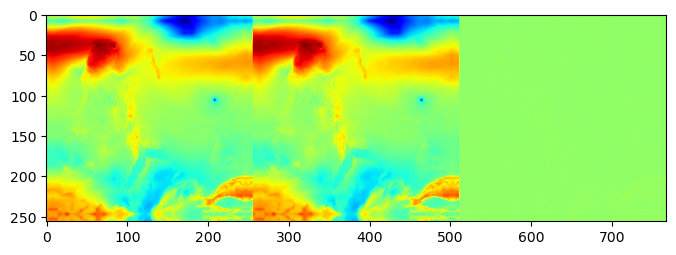

In [158]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import imageio
import numpy as np
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(8,5))
# residual = np.abs(gt_img - result_img)

residual = np.abs(gt_img_org - recons_img_org)

video = np.concatenate([gt_img_org, recons_img_org, residual], axis=-1)

im = ax.imshow(video[0], cmap="jet")

def update(frame):
    im.set_array(video[frame])
    return [im]

ani = animation.FuncAnimation(fig, update, frames=len(video), interval=1)

# Save as a GIF
ani.save("animation.gif", writer=animation.PillowWriter(fps=5))

# Display in Jupyter Notebook
HTML(ani.to_jshtml())

In [145]:
x = gt_img_org
y = recons_img_org

error = np.sqrt(np.mean((x - y)**2, axis = (1,2)))/(x.max()-x.min())
error

array([0.00303099, 0.00384922, 0.00382713, 0.00299706, 0.00364538,
       0.00365861, 0.00305615, 0.00369157, 0.0037382 , 0.00317508,
       0.00386838, 0.00387852, 0.00321062, 0.00393009, 0.00396568,
       0.00311586], dtype=float32)

In [160]:
x = gt_img_org
y = recons_img_org

error = np.sqrt(np.mean((x - y)**2, axis = (1,2)))/(x.max()-x.min())
np.mean(error)

0.0033802846

In [189]:
np.mean([0.00378991, 0.00424436, 0.00419226, 0.0037936 , 0.00438337,
       0.00447306, 0.00394405, 0.00442877, 0.00446887, 0.00403108])

0.0041749330000000005

In [113]:
(0.0044/0.0037)*0.0012

0.001427027027027027

In [125]:

recons_path = "./data/e3sm08_psl_2d.npz"

from mydataset.e3sm240 import Climate240

# results_folder = "./results/VD2_InstRange2Norm_4_16_E3SM64_OriginalDomain"

data_arg = {"data_path":recons_path,
            "var": [0],
            "n_frame":10,
            "downsampling":1,
            "input_size":256,"inst_norm": False, "norm_type":'range'}

dataset_recons = Climate240(data_arg)

*************** Loading E3SM ***************
Original Data Shape: (1, 6, 720, 240, 240)


In [154]:
z = dataset_recons[0]['input'].numpy()*0.001

In [155]:
z.shape

(10, 256, 256)

In [156]:
error = np.sqrt(np.mean((x -z)**2, axis = (1,2)))/(x.max()-x.min())
error

array([0.11044715, 0.10714993, 0.10403642, 0.1017014 , 0.10060147,
       0.10062701, 0.10138479, 0.10247825, 0.10335634, 0.10360845],
      dtype=float32)

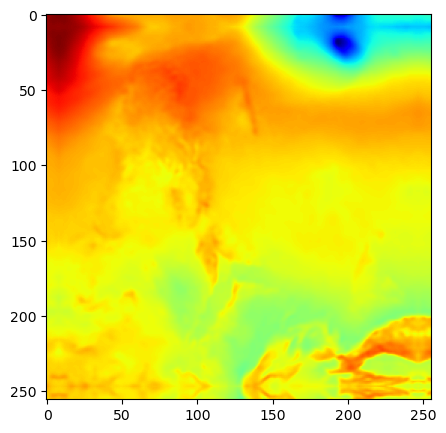

In [132]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import imageio
import numpy as np
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(8,5))
# residual = np.abs(gt_img - result_img)

# residual = np.abs(gt_img_org - recons_img_org)

video = z 

im = ax.imshow(video[0], cmap="jet")

def update(frame):
    im.set_array(video[frame])
    return [im]

ani = animation.FuncAnimation(fig, update, frames=len(video), interval=1)

# Save as a GIF
ani.save("animation.gif", writer=animation.PillowWriter(fps=5))

# Display in Jupyter Notebook
HTML(ani.to_jshtml())